In [ ]:
%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
seed = 6969
# seed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", seed)
random.seed(seed)
torch.manual_seed(seed)

Random Seed:  6969


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="J2QZBJqEOyk5GAobPfPV")
project = rf.workspace("ml-x00sj").project("ipd-yagxg")
version = project.version(1)
dataset = version.download("folder")

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.6/74.6 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 158.3/158.3 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 178.7/178.7 kB 17.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 5.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.1/49.1 MB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.4 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.9.0.80
    Uninstalling opencv-python-headless-4.9.0.80:
      Successfully uninstalled opencv-python-headless-4.9.0.80
  Attempting uninstall: idna
    Found existing installation: idna 3.7
    Uninstalling idna-3.7:
      Successfully uninstalled idna-3.7
  Attempting uninstall: cycler
    Found existing installation: cycler 0.12.1
    Uninstalling cycler-0.12.1:
      Successfully uninstalled cycler-0.1

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to ipd-1 in folder:: 100%|██████████| 2346/2346 [00:00<00:00, 4003.87it/s]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dataroot = "/content/ipd-1/train"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this size using a transformer.
image_size = 128 # Change image size to 300

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64
ndf = 64

# Number of training epochs
num_epochs = 100

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


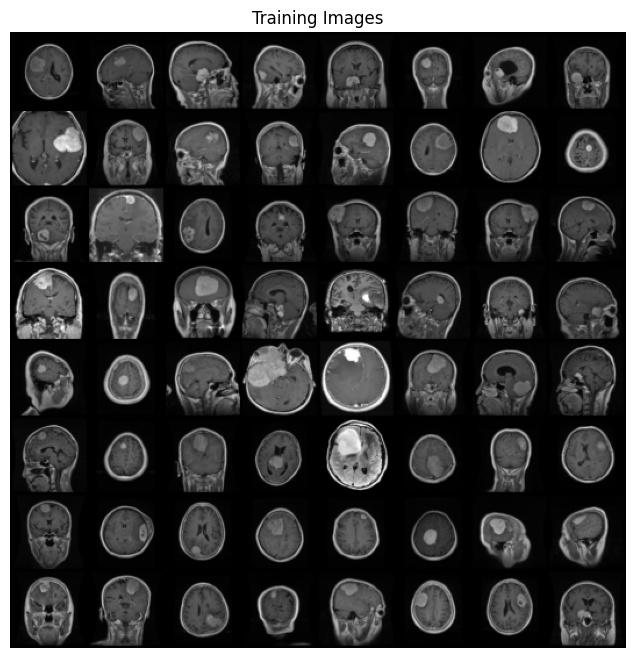

In [ ]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [ ]:
import cv2

im = cv2.imread('img.png')

print(type(im))
# <class 'numpy.ndarray'>

print(im.shape)



<class 'numpy.ndarray'>
(640, 640, 3)


In [ ]:
total_images_saved = (100 * len(dataloader)) / 150 + 100
print(total_images_saved)

112.66666666666667


In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # Input is a random noise vector, going into a transposed convolution
            nn.ConvTranspose2d(nz, ngf * 8, 4, 1, 0, bias=False),  # Increase spatial dimensions from 1x1 to 4x4
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),  # Increase spatial dimensions from 4x4 to 8x8
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),  # Increase spatial dimensions from 8x8 to 16x16
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),  # Increase spatial dimensions from 16x16 to 32x32
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf, ngf // 2, 4, 2, 1, bias=False),  # Increase spatial dimensions from 32x32 to 64x64
            nn.BatchNorm2d(ngf // 2),
            nn.ReLU(True),
            nn.ConvTranspose2d(ngf // 2, nc, 4, 2, 1, bias=False),  # Increase spatial dimensions from 64x64 to 128x128
            nn.Tanh()  # Output image with pixel values in the range [-1, 1]
        )

    def forward(self, input):
        return self.main(input)

In [ ]:
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): BatchNorm2d(

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 128 x 128
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),  # First convolutional layer, reduces spatial dimensions
            nn.LeakyReLU(0.2, inplace=True),  # LeakyReLU activation function
            # state size. (ndf) x 64 x 64
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),  # Second convolutional layer, increases channels, reduces spatial dimensions
            nn.BatchNorm2d(ndf * 2),  # Batch normalization
            nn.LeakyReLU(0.2, inplace=True),  # LeakyReLU activation function
            # state size. (ndf*2) x 32 x 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),  # Third convolutional layer, increases channels, reduces spatial dimensions
            nn.BatchNorm2d(ndf * 4),  # Batch normalization
            nn.LeakyReLU(0.2, inplace=True),  # LeakyReLU activation function
            # state size. (ndf*4) x 16 x 16
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),  # Fourth convolutional layer, increases channels, reduces spatial dimensions
            nn.BatchNorm2d(ndf * 8),  # Batch normalization
            nn.LeakyReLU(0.2, inplace=True),  # LeakyReLU activation function
            # state size. (ndf*8) x 8 x 8
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),  # Fifth convolutional layer, produces scalar output
            nn.Sigmoid()  # Sigmoid activation function, squashes output to range [0, 1]
        )

    def forward(self, input):
        return self.main(input)


In [ ]:
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [ ]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [ ]:
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        label = label.float()
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        errD_real = errD_real.sum()
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        output = netD(real_cpu).view(-1)  # Example of obtaining the discriminator's output
        print("Discriminator Output Size:", output.size())
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()



        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        # Update G network: maximize log(D(G(z)))
###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost

        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)

        # Reshape the label tensor to match the size of the output
        label = torch.full((output.size(0),), real_label, device=device)
        label = label.float()

        # Calculate G's loss based on this output
        errG = criterion(output, label)

        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 1000 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 250 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
Discriminator Output Size: torch.Size([64])
[0/100][0/37]	Loss_D: 1.7251	Loss_G: 0.9282	D(x): 0.4910	D(G(z)): 0.4910 / 0.4732
Discriminator Output Size: torch.Size([64])
Discriminator Output Size: torch.Size([64])
Discriminator Output Size: torch.Size([64])
Discriminator Output Size: torch.Size([64])
Discriminator Output Size: torch.Size([64])


KeyboardInterrupt: 

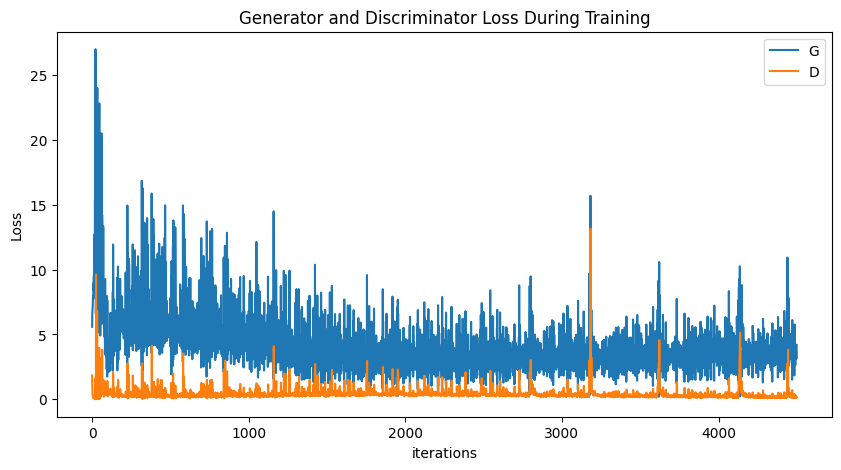

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

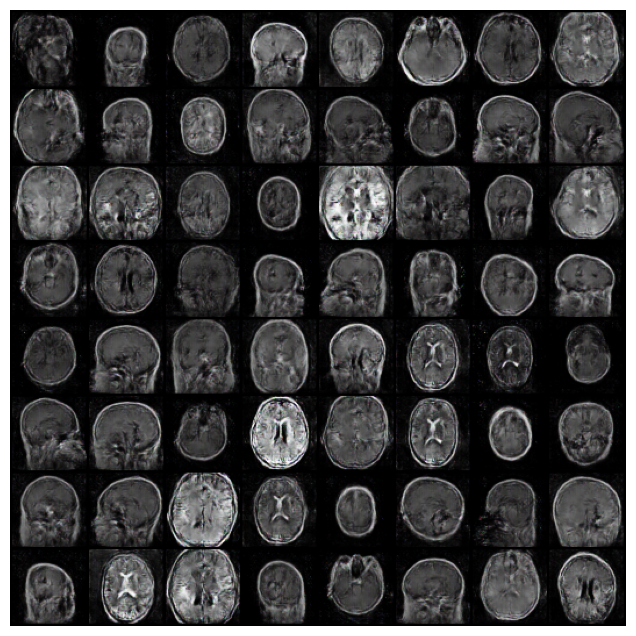

In [ ]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [ ]:
!pip install Pillow

In [ ]:
import os
from PIL import Image
save_dir = "generated_images"

# Create the directory if it doesn't exist
os.makedirs(save_dir, exist_ok=True)

# Iterate through the generated images and save them

for i, img in enumerate(img_list):
    img_path = os.path.join(save_dir, f"generated_image_{i}.png")
    vutils.save_image(img, img_path)  # Use torchvision.utils.save_image() to save the image
    print(f"Image {i+1} saved at {img_path}")

Image 1 saved at generated_images/generated_image_0.png
Image 2 saved at generated_images/generated_image_1.png
Image 3 saved at generated_images/generated_image_2.png
Image 4 saved at generated_images/generated_image_3.png
Image 5 saved at generated_images/generated_image_4.png
Image 6 saved at generated_images/generated_image_5.png
Image 7 saved at generated_images/generated_image_6.png
Image 8 saved at generated_images/generated_image_7.png
Image 9 saved at generated_images/generated_image_8.png
Image 10 saved at generated_images/generated_image_9.png
Image 11 saved at generated_images/generated_image_10.png
Image 12 saved at generated_images/generated_image_11.png
Image 13 saved at generated_images/generated_image_12.png
Image 14 saved at generated_images/generated_image_13.png
Image 15 saved at generated_images/generated_image_14.png
Image 16 saved at generated_images/generated_image_15.png
Image 17 saved at generated_images/generated_image_16.png
Image 18 saved at generated_image

In [ ]:
!zip -r generated_images.zip generated_images

  adding: generated_images/ (stored 0%)
  adding: generated_images/generated_image_2.png (deflated 0%)
  adding: generated_images/generated_image_14.png (deflated 0%)
  adding: generated_images/generated_image_7.png (deflated 0%)
  adding: generated_images/generated_image_11.png (deflated 0%)
  adding: generated_images/generated_image_16.png (deflated 0%)
  adding: generated_images/generated_image_4.png (deflated 0%)
  adding: generated_images/generated_image_1.png (deflated 0%)
  adding: generated_images/generated_image_18.png (deflated 0%)
  adding: generated_images/generated_image_10.png (deflated 0%)
  adding: generated_images/generated_image_5.png (deflated 0%)
  adding: generated_images/generated_image_8.png (deflated 0%)
  adding: generated_images/generated_image_12.png (deflated 0%)
  adding: generated_images/generated_image_15.png (deflated 0%)
  adding: generated_images/generated_image_0.png (deflated 0%)
  adding: generated_images/generated_image_9.png (deflated 0%)
  adding

In [ ]:
inal_fake_images = None
with torch.no_grad():
    final_fake_images = netG(fixed_noise).detach().cpu()

# Save the final generated images
output_dir = 'final_generated_images'
os.makedirs(output_dir, exist_ok=True)
for i, image_tensor in enumerate(final_fake_images):
    filename = os.path.join(output_dir, f'final_generated_image_{i}.png')
    vutils.save_image(image_tensor, filename, normalize=True)

In [ ]:
!zip -r final_generated_images.zip final_generated_images

  adding: final_generated_images/ (stored 0%)
  adding: final_generated_images/final_generated_image_16.png (stored 0%)
  adding: final_generated_images/final_generated_image_56.png (stored 0%)
  adding: final_generated_images/final_generated_image_30.png (stored 0%)
  adding: final_generated_images/final_generated_image_2.png (stored 0%)
  adding: final_generated_images/final_generated_image_36.png (stored 0%)
  adding: final_generated_images/final_generated_image_3.png (stored 0%)
  adding: final_generated_images/final_generated_image_61.png (stored 0%)
  adding: final_generated_images/final_generated_image_8.png (stored 0%)
  adding: final_generated_images/final_generated_image_15.png (stored 0%)
  adding: final_generated_images/final_generated_image_39.png (stored 0%)
  adding: final_generated_images/final_generated_image_60.png (stored 0%)
  adding: final_generated_images/final_generated_image_11.png (stored 0%)
  adding: final_generated_images/final_generated_image_14.png (stored